In [ ]:

!pip install opencv-python
!pip install opencv-python-headless

import cv2
print(cv2.__version__)


4.12.0


In [ ]:
from google.colab import files
uploaded = files.upload()


Saving images.jpg to images (1).jpg


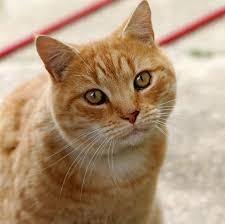

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)

In [ ]:
capture= cv2.VideoCapture()
while True:
isTrue, frame = capture.read()
cv2.imshow('video', frame)

if cv2.waitkey(20) & 0xFF== ord('d'):
  break
capture.release()
cv2.destroyAllwindows()

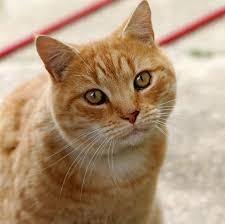

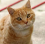

-1

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)

def rescaleFrame(frame, scale= 0.2):
  width= int(frame.shape[1]* scale)
  height = int(frame.shape[0]*scale)
  dimensions = (width, height)
  return cv2.resize(frame, dimensions, interpolation= cv2.INTER_AREA)

resized_image= rescaleFrame(img)
cv2_imshow(resized_image)
cv2.waitKey(0)

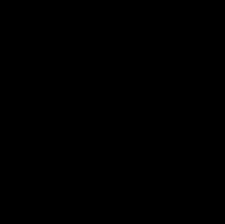

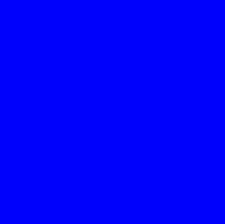

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
#cv2_imshow(img)

blank = np.zeros(img.shape, dtype='uint8')
cv2_imshow(blank)
blank[:]= 255,0,0
cv2_imshow(blank)
cv2.waitKey(0)

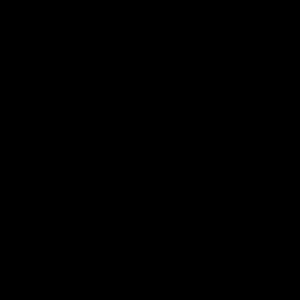

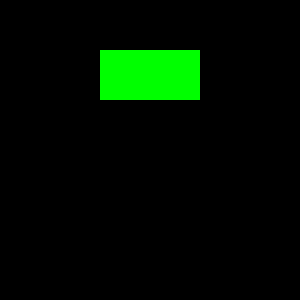

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

#img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
#cv2_imshow(img)

blank = np.zeros((300, 300, 3), dtype='uint8')
cv2_imshow(blank)
blank[50:100, 100:200]= 0,255,0
cv2_imshow(blank)
cv2.waitKey(0)

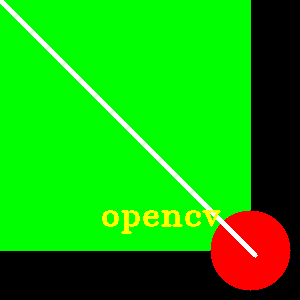

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

#img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
#cv2_imshow(img)

blank = np.zeros((300, 300, 3), dtype='uint8')
#cv2_imshow(blank)
#blank[50:100, 100:200]= 0,255,0
#cv2_imshow(blank)

cv2.rectangle(blank, (0,0), (250,250), (0,255,0), thickness=-1)
cv2.circle(blank, (250,250), 40, (0,0,255), thickness=-1)
cv2.line(blank,(0,0), (255,255),(255,255,255),thickness= 3 )
cv2.putText(blank, 'opencv', (100,225), cv2.FONT_HERSHEY_TRIPLEX, 1.0,(0,255,255), thickness=2)
cv2_imshow(blank)
cv2.waitKey(0)

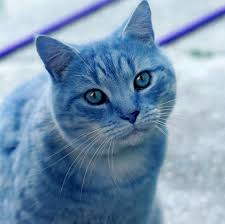

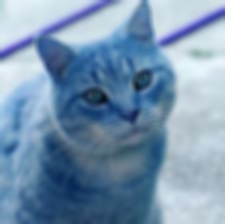

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
gray= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
blur= cv2.GaussianBlur(gray, (7,7), cv2.BORDER_DEFAULT)
cv2_imshow(gray)
cv2_imshow(blur)
cv2.waitKey(0)

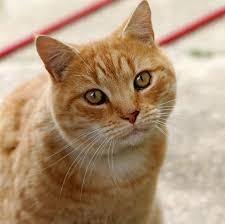

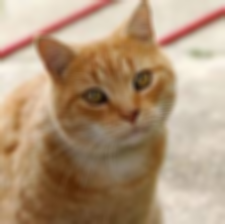

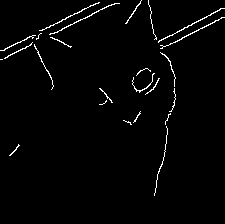

-1

In [ ]:
import cv2
img= cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)
blur= cv2.GaussianBlur(img, (7,7), cv2.BORDER_DEFAULT)
cv2_imshow(blur)
canny= cv2.Canny(blur, 125, 175)
cv2_imshow(canny)
cv2.waitKey(0)

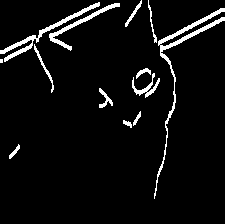

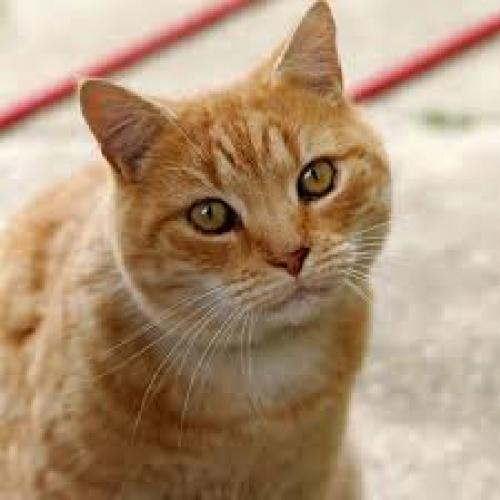

-1

In [ ]:
import cv2
img= cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
#cv2_imshow(img)
blur= cv2.GaussianBlur(img, (7,7), cv2.BORDER_DEFAULT)
#cv2_imshow(blur)
canny= cv2.Canny(blur, 125, 175)
#cv2_imshow(canny)
dilute= cv2.dilate(canny, (7,7), iterations = 3)
cv2_imshow(dilute)
eroded = cv2.erode(dilute, (7,7), iterations=3)
resize = cv2.resize(img, (500,500), interpolation=cv2.INTER_AREA)
cv2_imshow(resize)
cv2.waitKey(0)

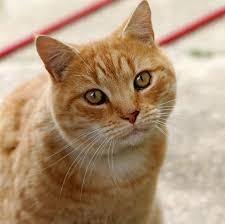

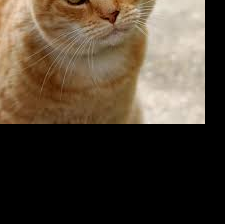

-1

In [ ]:
import cv2
img= cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)
def translate(img, x, y):
  transmat= np.float32([[1,0,x],[0,1,y]])
  dimensions=(img.shape[1], img.shape[0])
  return cv2.warpAffine(img, transmat, dimensions)
translated= translate(img, -20, -100)
cv2_imshow(translated)
cv2.waitKey(0)

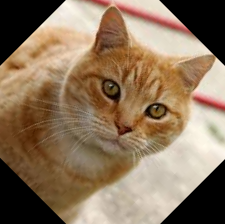

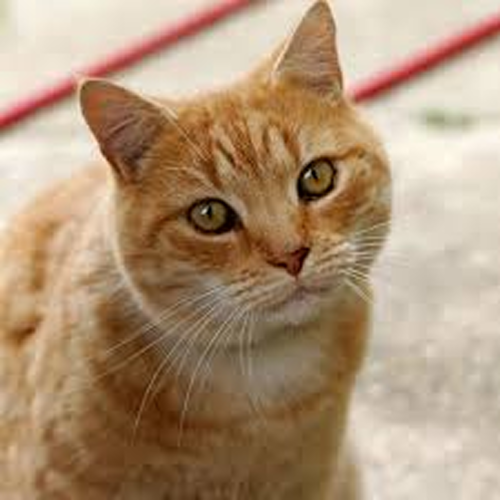

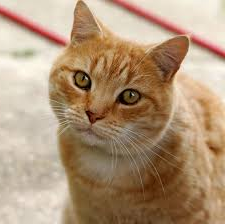

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
#cv2_imshow(img)
def rotate (img, angle, rotpoint=None):
  (height, width)= img.shape[:2]

  if rotpoint is None:
     rotpoint= (width//2, height//2)
  rotMat= cv2.getRotationMatrix2D(rotpoint, angle, 1.0)
  dimensions= (width, height)

  return cv2.warpAffine(img, rotMat, dimensions)
rotated = rotate(img, -45)
cv2_imshow(rotated)
resized= cv2.resize(img, (500,500), interpolation= cv2.INTER_CUBIC)
cv2_imshow(resized)
flip= cv2.flip(img,1)
cv2_imshow(flip)
cv2.waitKey(0)

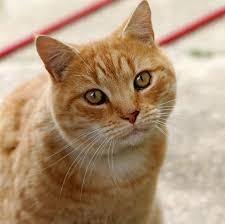

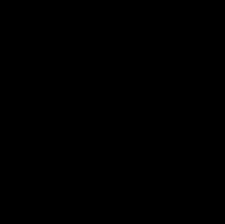

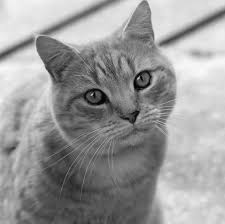

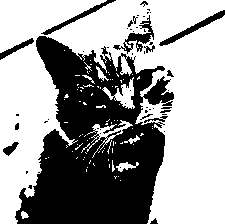

171 contour(s) found!


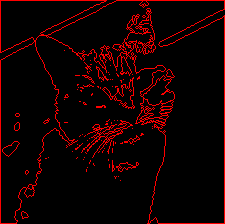

-1

In [ ]:
import cv2
import numpy as np

img= cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)

blank= np.zeros(img.shape, dtype='uint8')
cv2_imshow(blank)

gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)
blur= cv2.GaussianBlur(gray, (7,7), cv2.BORDER_DEFAULT)

#canny = cv2.Canny(blur, 125, 175)
#cv2_imshow(canny)
ret, thresh= cv2.threshold(gray, 125, 255, cv2.THRESH_BINARY)
cv2_imshow(thresh)
contours, hierarchies= cv2.findContours(thresh, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
print(f'{len(contours)} contour(s) found!')
cv2.drawContours(blank, contours, -1, (0,0,255), 1)
cv2_imshow(blank)
cv2.waitKey(0)


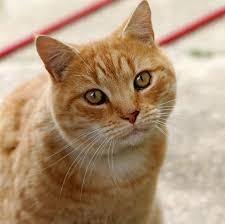

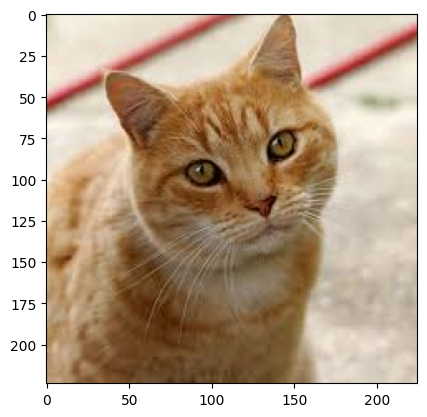

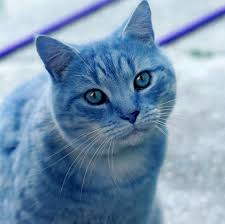

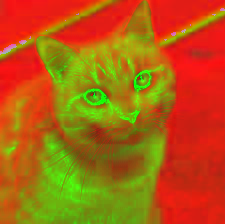

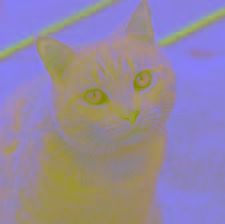

-1

In [ ]:
import cv2
import matplotlib.pyplot as plt

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)
rgb= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(rgb)
plt.show()

gray= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
cv2_imshow(gray)
#BGR to HSV
hsv= cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
cv2_imshow(hsv)
lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
cv2_imshow(lab)

cv2.waitKey(0)

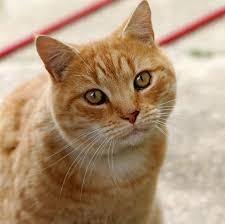

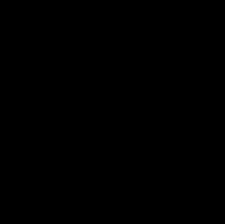

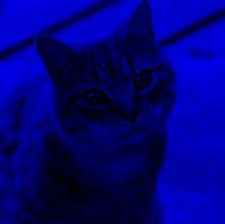

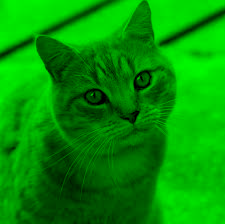

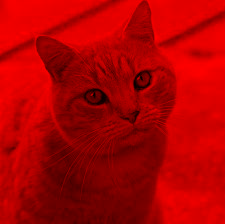

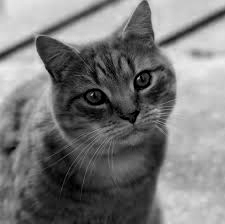

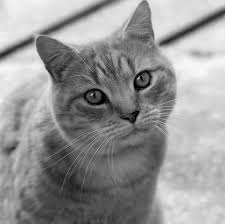

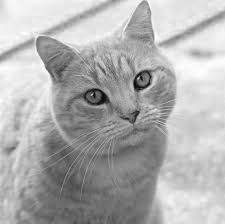

(224, 225, 3)
(224, 225)
(224, 225)
(224, 225)


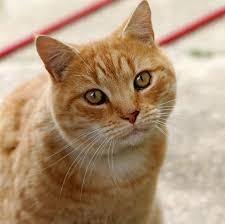

-1

In [ ]:
import cv2
import numpy as np

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)
blank = np.zeros(img.shape[:2], dtype='uint8')
cv2_imshow(blank)
blue = cv2.merge([b, blank, blank])
cv2_imshow(blue)
green = cv2.merge([blank, g, blank])
cv2_imshow(green)
red = cv2.merge([blank, blank, r])
cv2_imshow(red)
b,g,r = cv2.split(img)
cv2_imshow(b)
cv2_imshow(g)
cv2_imshow(r)
print(img.shape)
print(b.shape)
print(g.shape)
print(r.shape)
merged= cv2.merge([b,g,r])
cv2_imshow(merged)


cv2.waitKey(0)

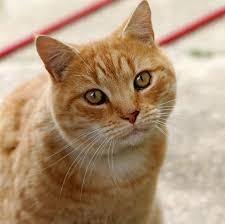

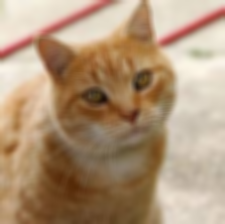

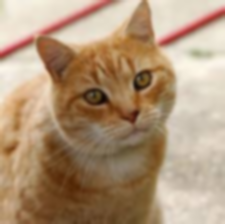

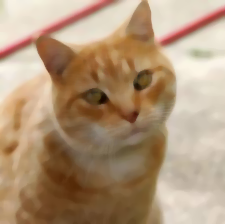

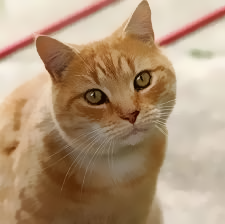

-1

In [ ]:
import cv2
img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)

average = cv2.blur(img, (7,7))
cv2_imshow(average)

gauss= cv2.GaussianBlur(img, (7,7), 0)
cv2_imshow(gauss)

median= cv2.medianBlur(img, 7)
cv2_imshow(median)

bilateral= cv2.bilateralFilter(img, 15, 35, 25)
cv2_imshow(bilateral)


cv2.waitKey(0)

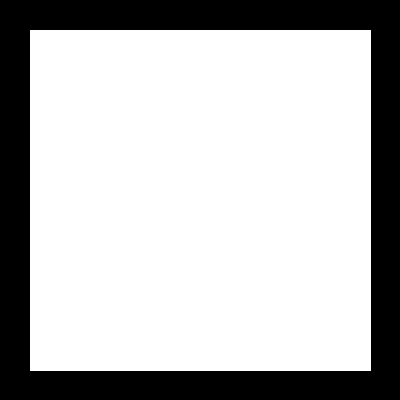

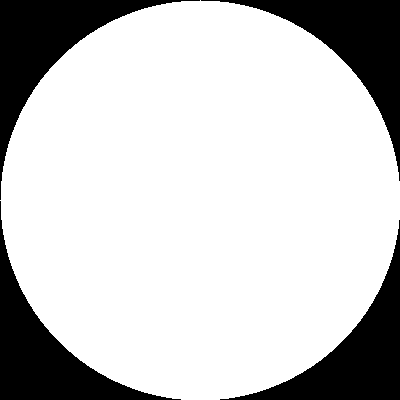

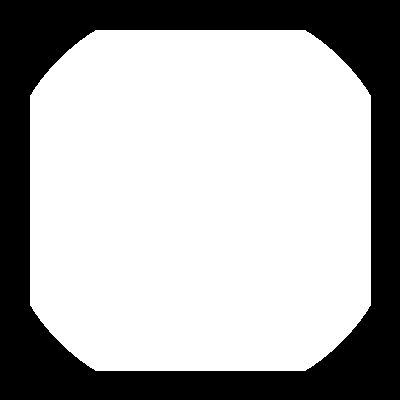

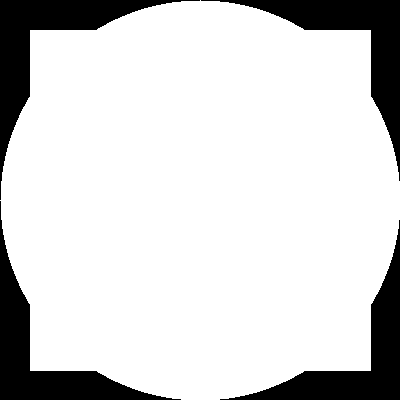

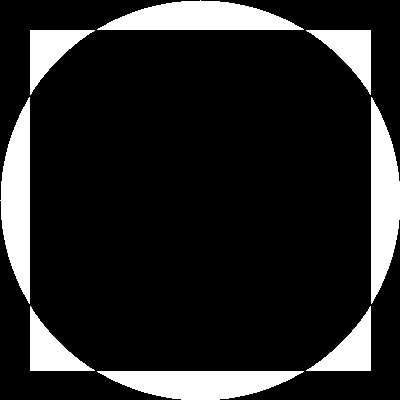

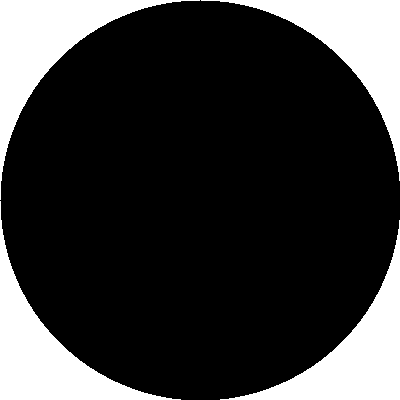

-1

In [ ]:
import cv2
import numpy as np
blank = np.zeros((400,400), dtype='uint8')
rectangle= cv2.rectangle(blank.copy(), (30,30), (370,370), 255, -1)
circle= cv2.circle(blank.copy(), (200,200),200, 255, -1)
cv2_imshow(rectangle)
cv2_imshow(circle)

bitwise_and= cv2.bitwise_and(rectangle, circle)
cv2_imshow(bitwise_and)
bitwise_or= cv2.bitwise_or(rectangle, circle)
cv2_imshow(bitwise_or)
bitwise_xor= cv2.bitwise_xor(rectangle, circle)
cv2_imshow(bitwise_xor)
bitwise_not= cv2.bitwise_not(circle)
cv2_imshow(bitwise_not)


cv2.waitKey(0)

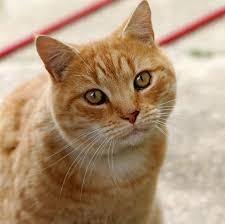

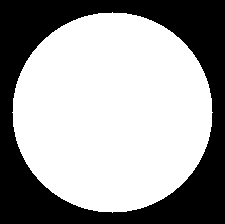

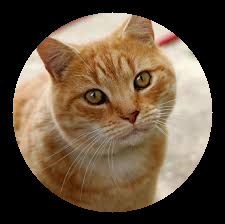

-1

In [ ]:
import cv2
import numpy as np
img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)

blank= np.zeros(img.shape[:2], dtype='uint8')
mask = cv2.circle(blank, (img.shape[1]//2 , img.shape[0]//2) , 100, 255, -1)
cv2_imshow(mask)
masked = cv2.bitwise_and(img, img, mask=mask)
cv2_imshow(masked)
cv2.waitKey(0)

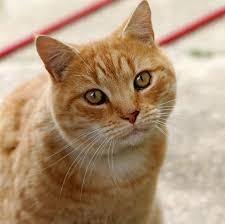

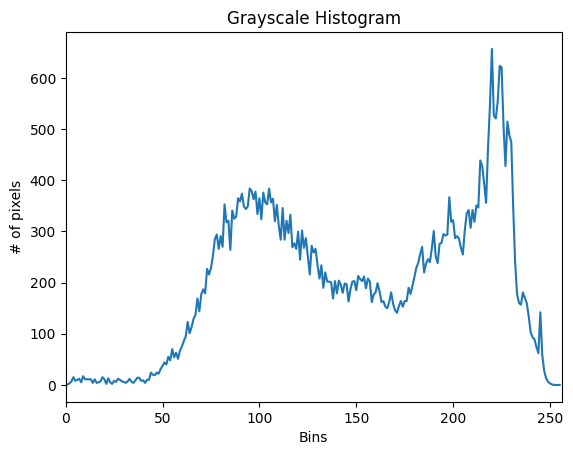

-1

In [ ]:
import cv2
import matplotlib.pyplot as plt
img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

gray_hist= cv2.calcHist([gray], [0], None, [256], [0,256])
plt.figure()
plt.title('Grayscale Histogram')
plt.xlabel('Bins')
plt.ylabel('# of pixels')
plt.plot(gray_hist)
plt.xlim([0,256])
plt.show()


cv2.waitKey(0)



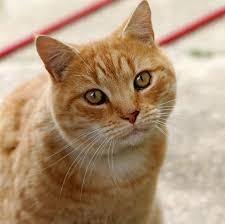

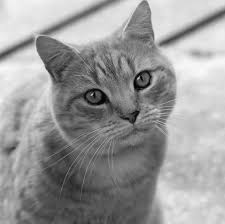

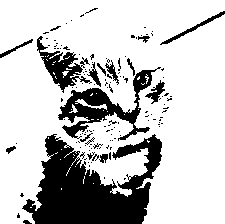

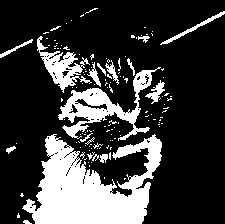

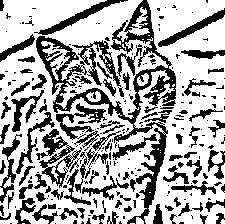

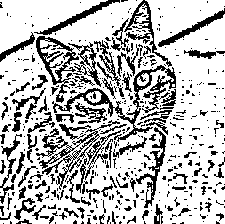

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)
gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)

threshold, thresh= cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY)
cv2_imshow(thresh)
threshold, thresh_inv= cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY_INV)
cv2_imshow(thresh_inv)
adaptive_thresh= cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 3)
cv2_imshow(adaptive_thresh)
adaptive_thresh= cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 3)
cv2_imshow(adaptive_thresh)

cv2.waitKey(0)

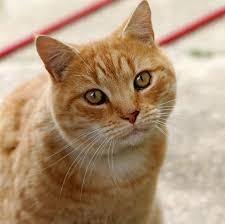

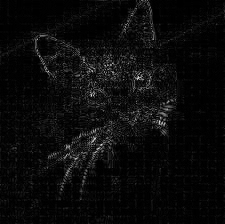

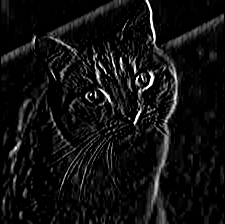

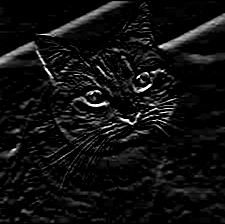

/usr/local/lib/python3.11/dist-packages/google/colab/patches/__init__.py:18: RuntimeWarning: invalid value encountered in cast
  a = a.clip(0, 255).astype('uint8')


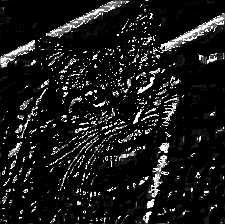

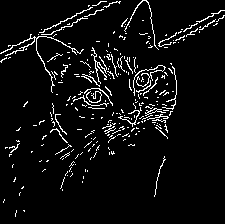

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img= cv2.imread('/content/drive/MyDrive/Colab Notebooks/cat.jpg')
cv2_imshow(img)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

lap= cv2.Laplacian(gray, cv2.CV_64F)
lap= np.uint8(np.absolute(lap))
cv2_imshow(lap)

sobelx= cv2.Sobel(gray, cv2.CV_64F, 1,0)
sobely= cv2.Sobel(gray, cv2.CV_64F, 0,1)
combined_sobel= cv2.bitwise_or(sobelx, sobely)
cv2_imshow(sobelx)
cv2_imshow(sobely)
cv2_imshow(combined_sobel)

canny= cv2.Canny(gray, 150, 175)
cv2_imshow(canny)
cv2.waitKey(0)

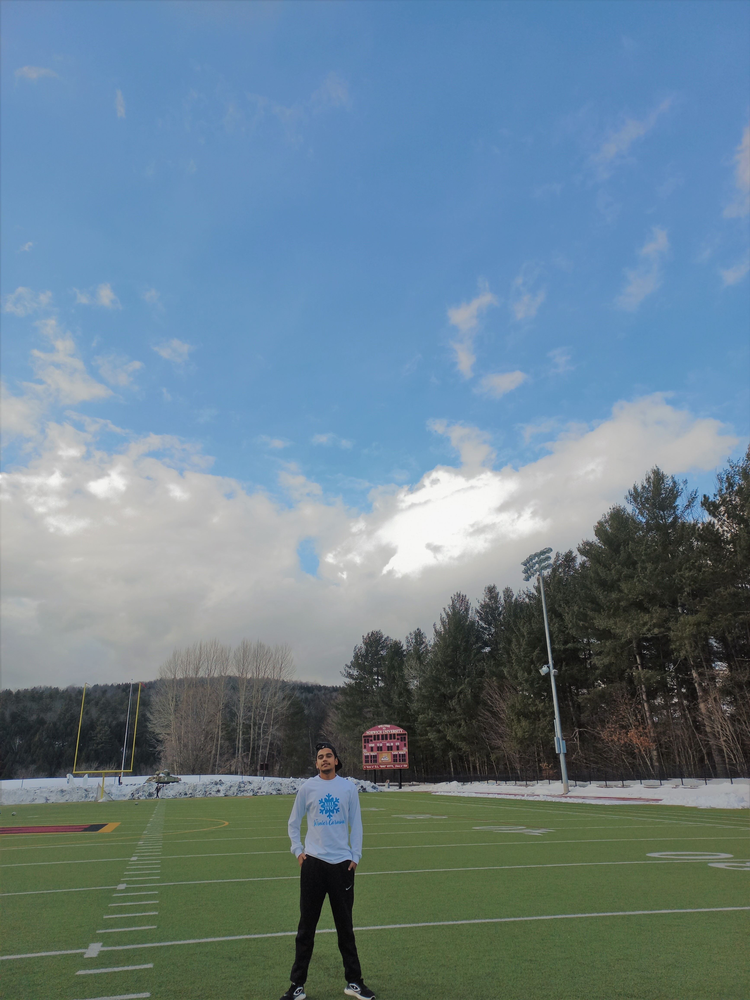

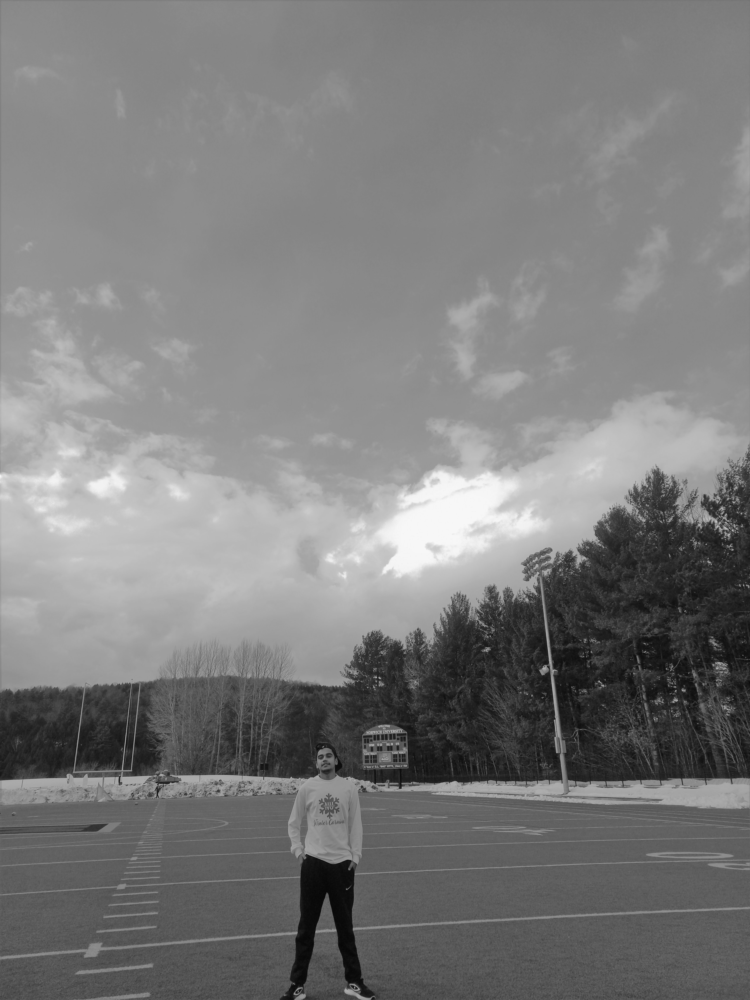

Number of faces found= 1


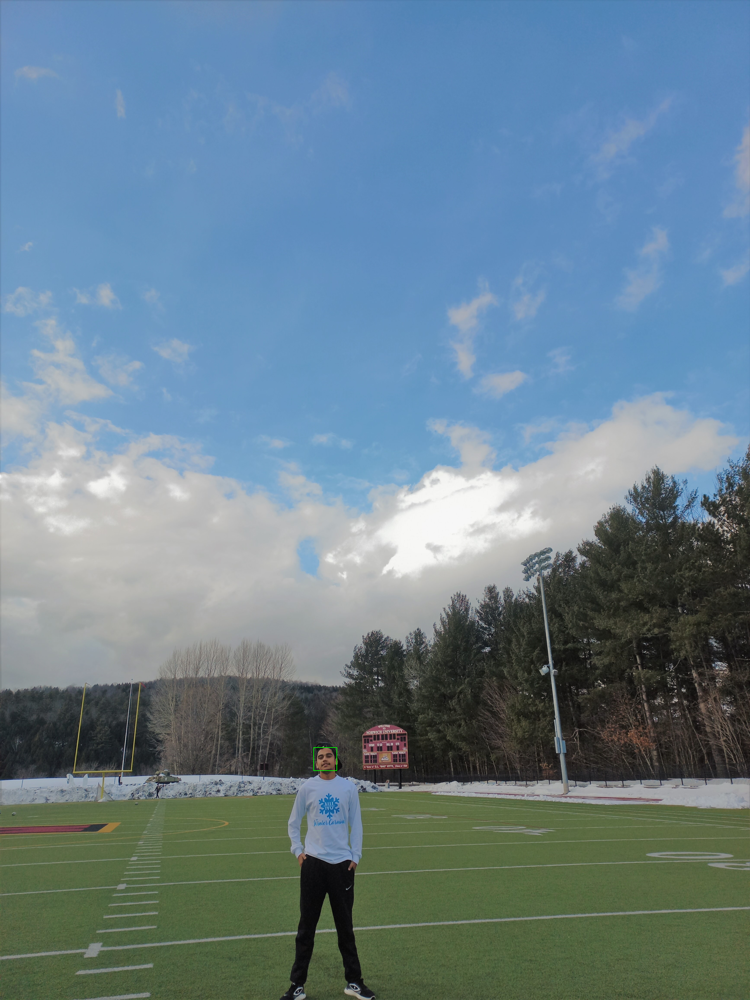

-1

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img= cv2.imread('/content/drive/MyDrive/Colab Notebooks/q.jpg')
cv2_imshow(img)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)
haar_cascade= cv2.CascadeClassifier('haar_face.xml')
faces_rect= haar_cascade.detectMultiScale(gray, scaleFactor= 1.1, minNeighbors=6)
print(f'Number of faces found= {len(faces_rect)}')
for (x,y,w,h)in faces_rect:
  cv2.rectangle(img, (x,y), (x+w, y+h), (0, 255, 0), thickness= 2)
cv2_imshow(img)
cv2.waitKey(0)